<a href="https://colab.research.google.com/github/GusFontana404/VisionPorComputadora/blob/main/Unidad%201/EjerciciosU1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

### **Ejercicio 1**

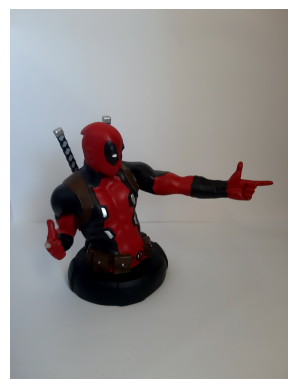

In [ ]:
img = cv2.imread("/content/drive/MyDrive/Visión /Fotos y Videos/20240321_143540.jpg")
img_fondo = cv2.imread("/content/drive/MyDrive/Visión /Fotos y Videos/20240321_144910.jpg")
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img_fondo = cv2.cvtColor(img_fondo, cv2.COLOR_BGR2GRAY)

plt.axis('off'), plt.imshow(img), plt.show(block=False);

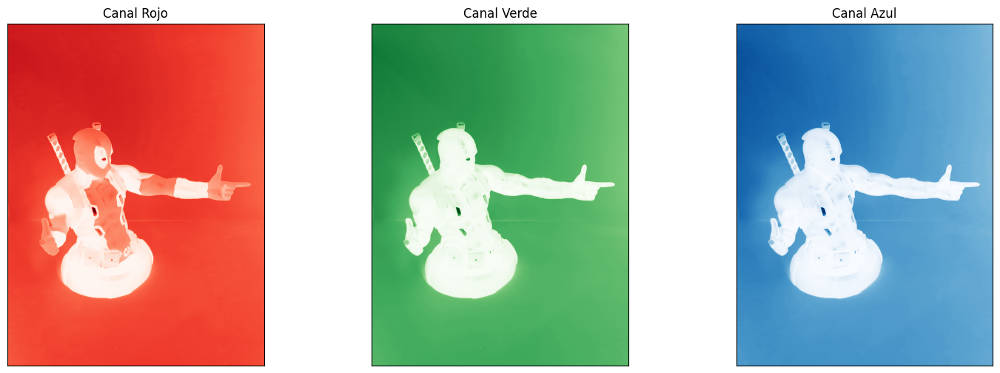

In [ ]:
# Separar la imagen en los canales de color R, G, B
R, G, B = img[:,:,0], img[:,:,1], img[:,:,2]

# Mostrar cada canal de color
fig, axs = plt.subplots(1, 3, figsize=(18, 6))

axs[0].imshow(R, cmap='Reds')
axs[0].set_title('Canal Rojo')

axs[1].imshow(G, cmap='Greens')
axs[1].set_title('Canal Verde')

axs[2].imshow(B, cmap='Blues')
axs[2].set_title('Canal Azul')

for ax in axs:
    ax.set_xticks([])
    ax.set_yticks([])

plt.show()

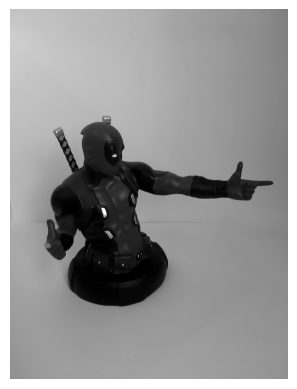

In [ ]:
img_gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
plt.axis('off'), plt.imshow(img_gray, cmap='gray'), plt.show(block=False);

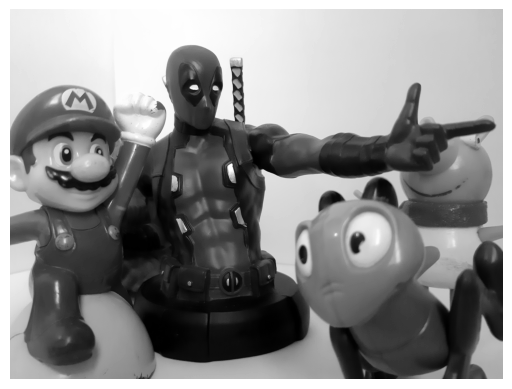

In [ ]:
plt.axis('off'), plt.imshow(img_fondo, cmap='gray'), plt.show(block=False);

### **Ejercicio 2**

**Con BFMatcher**

In [ ]:
# Cargar las imágenes

def emparejar(img_original, img_transf):
  image1 = cv2.imread(img_original, cv2.IMREAD_GRAYSCALE)
  image2 = cv2.imread(img_transf, cv2.IMREAD_GRAYSCALE)

  # Inicializar ORB
  orb = cv2.ORB_create()

  # Detectar keypoints y calcular descriptores
  keypoints1, descriptors1 = orb.detectAndCompute(image1, None)
  keypoints2, descriptors2 = orb.detectAndCompute(image2, None)

  # Crear un objeto BFMatcher para encontrar las coincidencias
  bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

  # Encontrar coincidencias
  matches = bf.match(descriptors1, descriptors2)

  # Ordenar las coincidencias en orden de distancia (cuanto más baja, mejor)
  matches = sorted(matches, key=lambda x:x.distance)

  # Dibujar las primeras 15 coincidencias
  matched_img = cv2.drawMatches(image1, keypoints1, image2, keypoints2, matches[:15], outImg=None, flags=2)

  # Ajustar el tamaño de la figura de matplotlib
  plt.figure(figsize=(15, 20))
  plt.imshow(cv2.cvtColor(matched_img, cv2.COLOR_BGR2RGB))
  plt.title('Emparejamiento de Imágenes')
  plt.axis('off')
  plt.show()

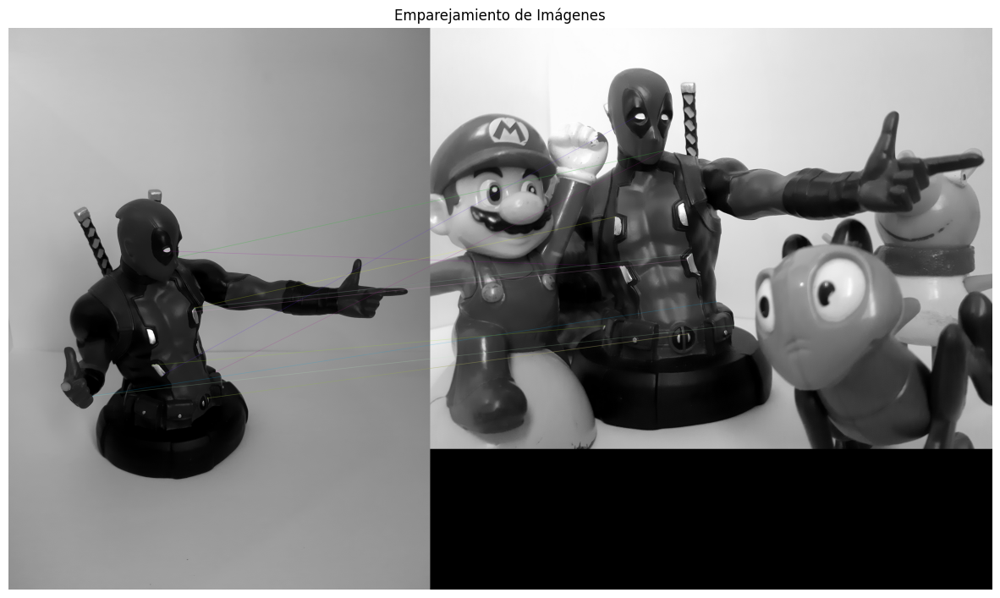

In [ ]:
emparejar('/content/drive/MyDrive/Visión /Fotos y Videos/20240321_143540.jpg', '/content/drive/MyDrive/Visión /Fotos y Videos/20240321_144910.jpg')

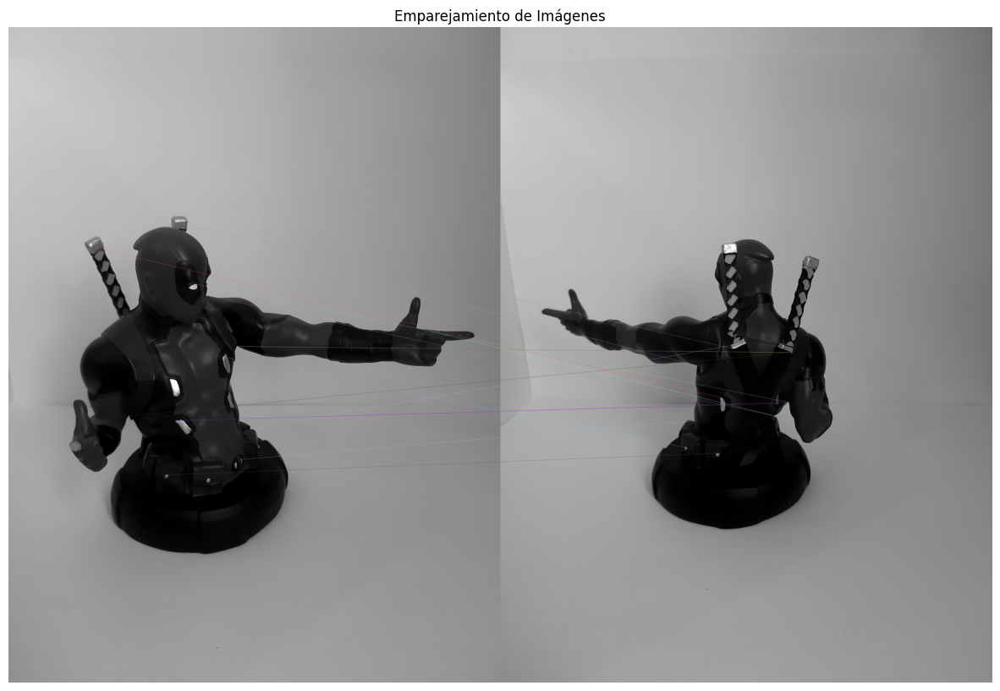

In [ ]:
emparejar('/content/drive/MyDrive/Visión /Fotos y Videos/20240321_143540.jpg', '/content/drive/MyDrive/Visión /Fotos y Videos/20240321_143707.jpg')

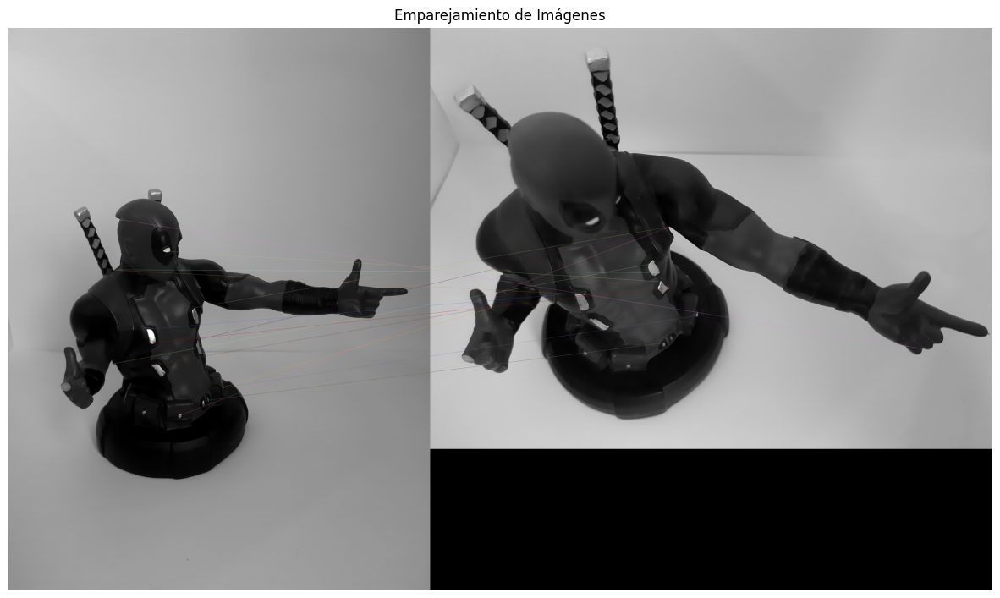

In [ ]:
emparejar('/content/drive/MyDrive/Visión /Fotos y Videos/20240321_143540.jpg', '/content/drive/MyDrive/Visión /Fotos y Videos/20240321_143742.jpg')

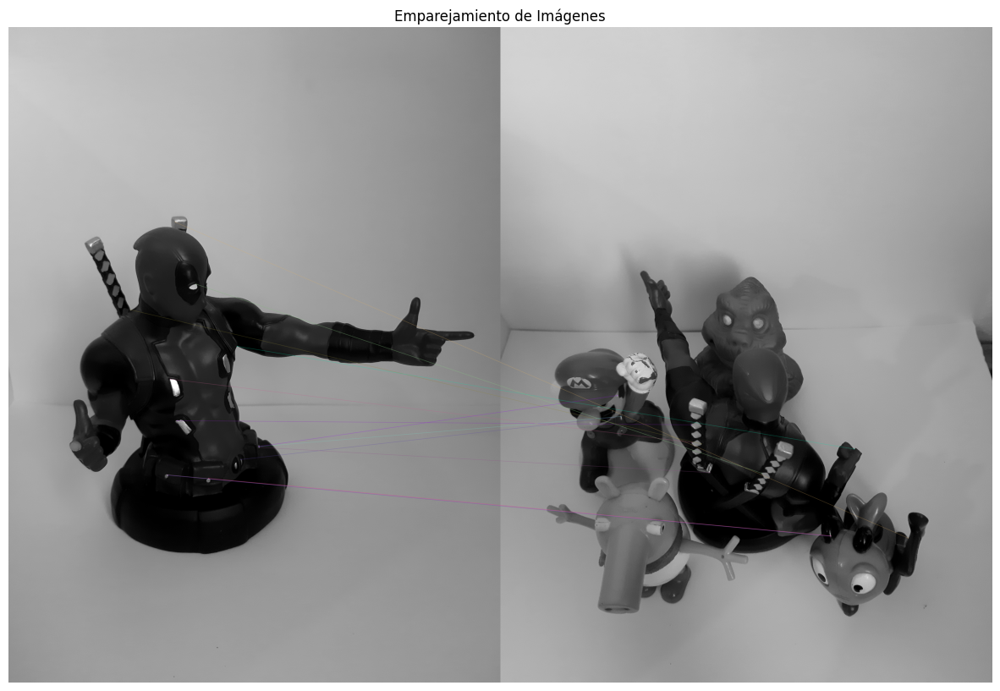

In [ ]:
emparejar('/content/drive/MyDrive/Visión /Fotos y Videos/20240321_143540.jpg', '/content/drive/MyDrive/Visión /Fotos y Videos/20240321_144701.jpg')

**Con FLANN**

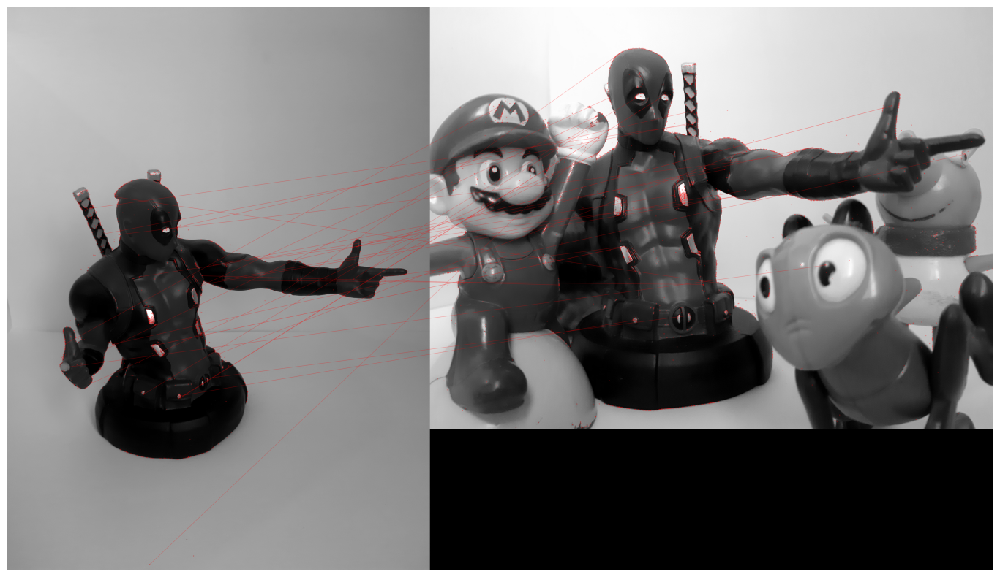

In [ ]:
# Cargar imágenes en escala de grises
img1 = cv2.imread('/content/drive/MyDrive/Visión /Fotos y Videos/20240321_143540.jpg', cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread('/content/drive/MyDrive/Visión /Fotos y Videos/20240321_144910.jpg', cv2.IMREAD_GRAYSCALE)

# Iniciar el detector SIFT
sift = cv2.SIFT_create()

# Encontrar los keypoints y descriptores con SIFT
kp1, des1 = sift.detectAndCompute(img1, None)
kp2, des2 = sift.detectAndCompute(img2, None)

# Parámetros FLANN
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
search_params = dict(checks=50)  # o pasar un diccionario vacío

# Iniciar FLANN matcher
flann = cv2.FlannBasedMatcher(index_params, search_params)

# Realizar emparejamientos kNN
matches = flann.knnMatch(des1, des2, k=2)

# Necesitamos dibujar solo los buenos emparejamientos, por lo que creamos una máscara
matchesMask = [[0, 0] for i in range(len(matches))]

# Test de proporción según el artículo de Lowe (https://www.robots.ox.ac.uk/~vgg/research/affine/det_eval_files/lowe_ijcv2004.pdf)
for i, (m, n) in enumerate(matches):
    if m.distance < 0.7 * n.distance:
        matchesMask[i] = [1, 0]

# Parámetros de dibujo para los emparejamientos
draw_params = dict(matchColor=(255, 0, 0),  # color de los emparejamientos
                   singlePointColor=(255, 0, 0),  # color de los puntos individuales
                   matchesMask=matchesMask,  # máscara para seleccionar emparejamientos
                   flags=cv2.DrawMatchesFlags_DEFAULT)

# Dibujar los emparejamientos kNN
img3 = cv2.drawMatchesKnn(img1, kp1, img2, kp2, matches, None, **draw_params)

# Mostrar la imagen resultante

plt.figure(figsize=(20,10)),plt.axis('off'), plt.imshow(img3), plt.show();

### **Ejercicio 4**

**Deteccón de movimiento**

In [ ]:
!pip install -q mediapy
import mediapy as media

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 6.3 MB/s eta 0:00:00


In [ ]:
video_1 = media.read_video('/content/drive/MyDrive/Visión /Fotos y Videos/Screen_Recording_20240321-152036_YouTube_0012.mp4')
video_2 = media.read_video('/content/drive/MyDrive/Visión /Fotos y Videos/Screen_Recording_20240321-152247_YouTube1_001.mp4')

In [ ]:
# Función para oscurecer una imagen:
def process_image(new_image, prev_image, **kwargs):
    # Convertir la imagen a float32
    new_image_float = new_image.astype(np.float32)

    # Reducir el brillo de la imagen a la mitad
    new_image_float *= 0.5

    # Convertir la imagen de vuelta a uint8
    new_image_uint8 = np.clip(new_image_float, 0, 255).astype(np.uint8)

    return new_image_uint8

# Función para procesar un video:
def video_processor(filename_in, filename_out, process_func, max_time=10, **kwargs):
    # Abrir el video de entrada para lectura
    with media.VideoReader(filename_in) as r:
        # Crear un archivo de video de salida
        with media.VideoWriter(filename_out, shape=r.shape, fps=r.fps, bps=r.bps) as w:
            count = 0  # Inicializar contador de fotogramas
            prev_image = None  # Inicializar la imagen previa

            # Iterar sobre cada imagen (fotograma) del video
            for image in r:
                new_image = media.to_uint8(image)  # Convertir la imagen a formato flotante

                # Comprobar si es la primera imagen
                if prev_image is None:
                    prev_image = new_image.copy()

                # Procesar la imagen utilizando la función dada
                processed_image = process_func(new_image, prev_image, **kwargs)

                # Añadir la imagen procesada al video de salida
                w.add_image(processed_image)

                # Actualizar la imagen previa
                prev_image = new_image.copy()

                # Incrementar el contador de fotogramas
                count += 1

                # Detener el proceso si se alcanza el tiempo máximo
                if count >= max_time * r.fps:
                    break

# Función actualizada para realizar diferencia de fotogramas con normalización:
def process_frame_difference(new_image, prev_image, **kwargs):
    # Convertir las imágenes a escala de grises
    new_gray = cv2.cvtColor(new_image, cv2.COLOR_RGB2GRAY)
    prev_gray = cv2.cvtColor(prev_image, cv2.COLOR_RGB2GRAY)

    # Calcular la diferencia absoluta entre los fotogramas actual y anterior
    frame_diff = cv2.absdiff(new_gray, prev_gray)

    # Normalizar la imagen de diferencia
    norm_diff = cv2.normalize(frame_diff, None, 0, 255, cv2.NORM_MINMAX)

    # Umbralizar la imagen para resaltar las diferencias
    _, thresh = cv2.threshold(norm_diff, 30, 255, cv2.THRESH_BINARY)

    # Convertir la imagen umbralizada a color para mantener la consistencia con el video original
    thresh_color = cv2.cvtColor(thresh, cv2.COLOR_GRAY2RGB)

    return thresh_color

In [ ]:
media.show_video(video_2)

**Sustracción de frames**

In [ ]:
# Nombres de los archivos de video de entrada y salida
filename_in = '/content/drive/MyDrive/Visión /Fotos y Videos/Screen_Recording_20240321-152247_YouTube1_001.mp4'
filename_out = 'video_1_dark.mp4'

# Llamar a la función para procesar el video
video_processor(filename_in, filename_out, process_frame_difference, 10)

# Mostrar el video resultante
media.show_video(media.read_video(filename_out), fps=30)

### **Optical Flow**

**O.F - Sparse**

In [ ]:
def process_sparse_optical_flow(new_image, prev_image):
    # Preparamos las imagenes de trabajo
    new_gray = cv2.cvtColor(new_image, cv2.COLOR_BGR2GRAY)
    prev_gray_image = cv2.cvtColor(prev_image, cv2.COLOR_BGR2GRAY)

    # Verificar si ya se han detectado las características de Shi-Tomasi
    if not hasattr(process_sparse_optical_flow, "shi_tomasi_done"):
        # Definir parámetros para la detección de esquinas de Shi-Tomasi
        feature_params = dict(maxCorners=300, qualityLevel=0.2, minDistance=2, blockSize=7)
        # Detectar puntos característicos en la imagen
        process_sparse_optical_flow.prev_points = cv2.goodFeaturesToTrack(new_gray, mask=None, **feature_params)
        # Crear una máscara para dibujar el flujo óptico
        process_sparse_optical_flow.mask = np.zeros_like(new_image)
        # Marcar que se ha completado la detección de Shi-Tomasi
        process_sparse_optical_flow.shi_tomasi_done = True

    # Continuar si se ha completado la detección de Shi-Tomasi
    if process_sparse_optical_flow.shi_tomasi_done:
        prev_points = process_sparse_optical_flow.prev_points
        mask = process_sparse_optical_flow.mask

    # Parámetros para el flujo óptico de Lucas-Kanade
    lk_params = dict(winSize=(15, 15), maxLevel=2,
                     criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03))

    # Calcular el flujo óptico de Lucas-Kanade
    new_points, status, error = cv2.calcOpticalFlowPyrLK(prev_gray_image, new_gray, prev_points, None, **lk_params)
    # Filtrar puntos buenos
    good_old = prev_points[status == 1]
    good_new = new_points[status == 1]
    color = (0, 255, 0)  # Color para el dibujo
    # Dibujar el movimiento (flujo óptico)
    for i, (new, old) in enumerate(zip(good_new, good_old)):
        a, b = new.astype(int).ravel()
        c, d = old.astype(int).ravel()
        mask = cv2.line(mask, (a, b), (c, d), color, 2)
        new_image = cv2.circle(new_image, (a, b), 3, color, -1)

    # Combinar la imagen actual con las líneas de flujo óptico dibujadas
    output = cv2.add(new_image, mask)
    # Actualizar puntos para el siguiente cuadro
    process_sparse_optical_flow.prev_points = good_new.reshape(-1, 1, 2)
    return output

In [ ]:
# Nombres de los archivos de video de entrada y salida
filename_in = '/content/drive/MyDrive/Visión /Fotos y Videos/Screen_Recording_20240321-152247_YouTube1_001.mp4'
filename_out = 'video_1_dark.mp4'

# Llamar a la función para procesar el video
video_processor(filename_in, filename_out, process_sparse_optical_flow,
                max_time=10)

# Mostrar el video resultante
media.show_video(media.read_video(filename_out), fps=30)

**OF - Dense**

In [ ]:
# Función para procesar el flujo óptico denso
def process_dense_optical_flow(new_image, prev_image):
    # Convierte la nueva imagen a escala de grises
    gray = cv2.cvtColor(new_image, cv2.COLOR_BGR2GRAY)

    if not hasattr(process_dense_optical_flow, "init_done"):
        process_dense_optical_flow.prev_gray = cv2.cvtColor(new_image, cv2.COLOR_BGR2GRAY)
        process_dense_optical_flow.mask = np.zeros_like(new_image)
        process_dense_optical_flow.mask[..., 1] = 255
        process_dense_optical_flow.init_done = True

    if process_dense_optical_flow.init_done:
        prev_gray = process_dense_optical_flow.prev_gray
        mask = process_dense_optical_flow.mask

    # Calcula el flujo óptico
    flow = cv2.calcOpticalFlowFarneback(prev_gray, gray, None, 0.5, 3, 15, 3, 5, 1.2, 0)
    # Computa magnitud y ángulo de los vectores 2D
    magnitude, angle = cv2.cartToPolar(flow[..., 0], flow[..., 1])
    # Establece el tono de la imagen según la dirección del flujo óptico
    mask[..., 0] = angle * 180 / np.pi / 2
    # Establece el valor de la imagen según la magnitud del flujo óptico
    mask[..., 2] = cv2.normalize(magnitude, None, 0, 255, cv2.NORM_MINMAX)
    # Convierte de HSV a RGB
    rgb = cv2.cvtColor(mask, cv2.COLOR_HSV2BGR)
    # Actualiza la imagen previa a gris
    process_dense_optical_flow.prev_grayprev_gray = gray.copy()
    return rgb

In [ ]:
# Nombres de los archivos de video de entrada y salida
filename_in = '/content/drive/MyDrive/Visión /Fotos y Videos/Screen_Recording_20240321-152247_YouTube1_001.mp4'
filename_out = 'video_1_dark.mp4'

# Llamar a la función para procesar el video
video_processor(filename_in, filename_out, process_dense_optical_flow,
                max_time=20)

# Mostrar el video resultante
media.show_video(media.read_video(filename_out), fps=30)